# Подгрузка модели: huggingface

In [1]:
!pip install diffusers transformers accelerate safetensors --upgrade

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 80.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.7/354.7 kB 31.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 68.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 35.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 45.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 21.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 41.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu

In [2]:
from diffusers import DiffusionPipeline, AutoencoderKL
import torch

# Загружаем VAE
vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)

# Загружаем базовую модель SDXL
pipe = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    vae=vae,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)

# Загружаем LoRA
repo_id = "imnlv/buffet_style_LoRA"
pipe.load_lora_weights(repo_id)

# Отправляем на GPU
pipe.to("cuda")


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/631 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 17 files:   0%|          | 0/17 [00:00<?, ?it/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

StableDiffusionXLPipeline {
  "_class_name": "StableDiffusionXLPipeline",
  "_diffusers_version": "0.32.2",
  "_name_or_path": "stabilityai/stable-diffusion-xl-base-1.0",
  "feature_extractor": [
    null,
    null
  ],
  "force_zeros_for_empty_prompt": true,
  "image_encoder": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "EulerDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

# Генерации: Clown. Part 2 - Scenes with clowns

  0%|          | 0/50 [00:00<?, ?it/s]

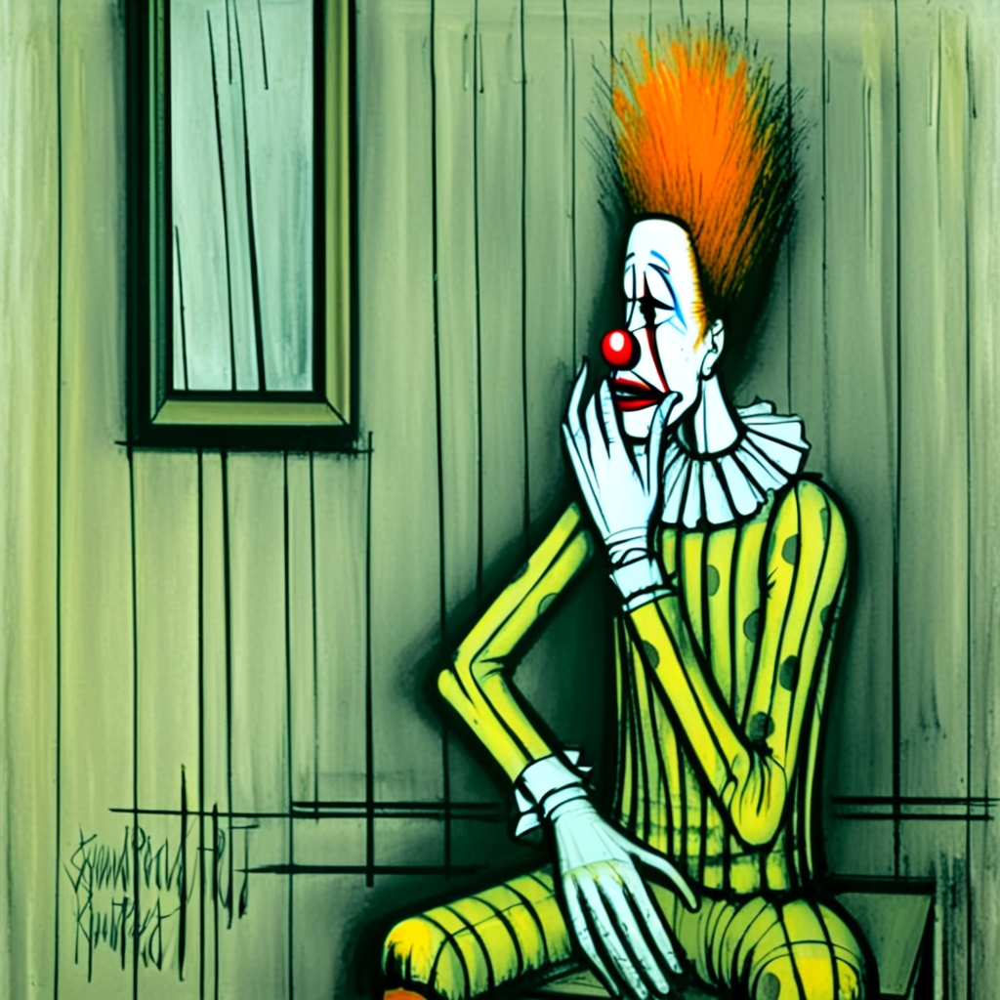

In [8]:
# Генерация изображения
prompt = "photo collage in BUFFET style, a sad clown sitting before a cracked mirror, smudged makeup, worn-out gloves on the table. Rough, expressive lines."
image = pipe(prompt, num_inference_steps=50, guidance_scale=8.0).images[0]

# Результат
image


  0%|          | 0/50 [00:00<?, ?it/s]

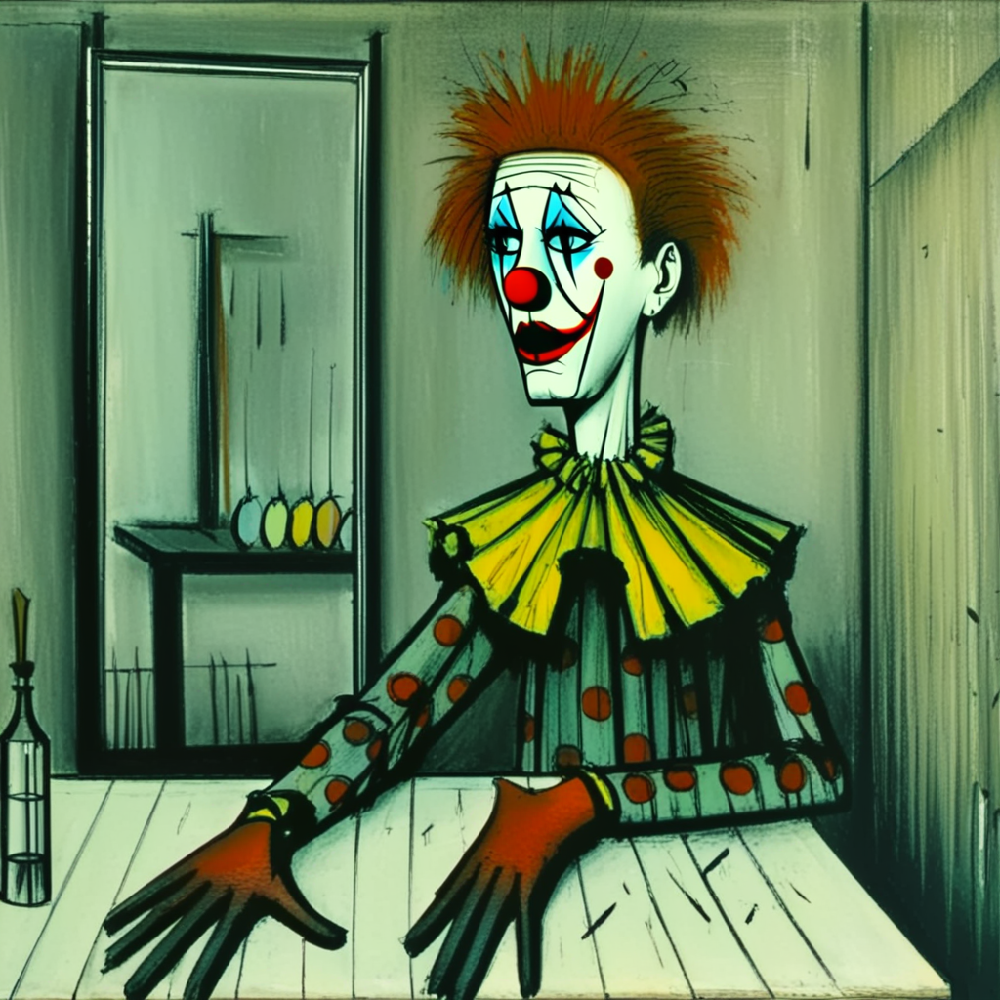

In [9]:
# Генерация изображения
prompt = "photo collage in BUFFET style, a sad clown sitting before a cracked mirror, smudged makeup, worn-out gloves on the table. Rough, expressive lines."
image = pipe(prompt, num_inference_steps=50, guidance_scale=8.0).images[0]

# Результат
image


  0%|          | 0/50 [00:00<?, ?it/s]

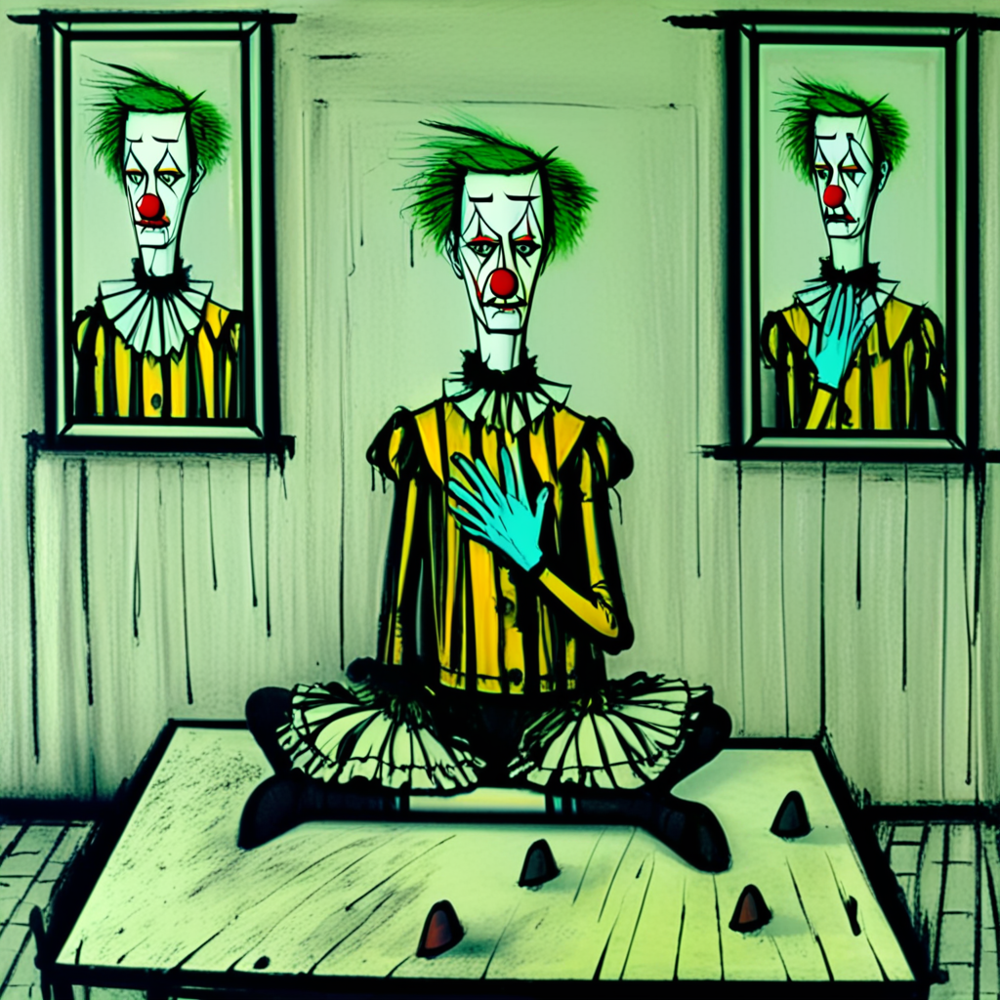

In [10]:
# Генерация изображения
prompt = "photo collage in BUFFET style, a sad clown sitting before a cracked mirror, smudged makeup, worn-out gloves on the table. Rough, expressive lines."
image = pipe(prompt, num_inference_steps=50, guidance_scale=8.0).images[0]

# Результат
image


  0%|          | 0/50 [00:00<?, ?it/s]

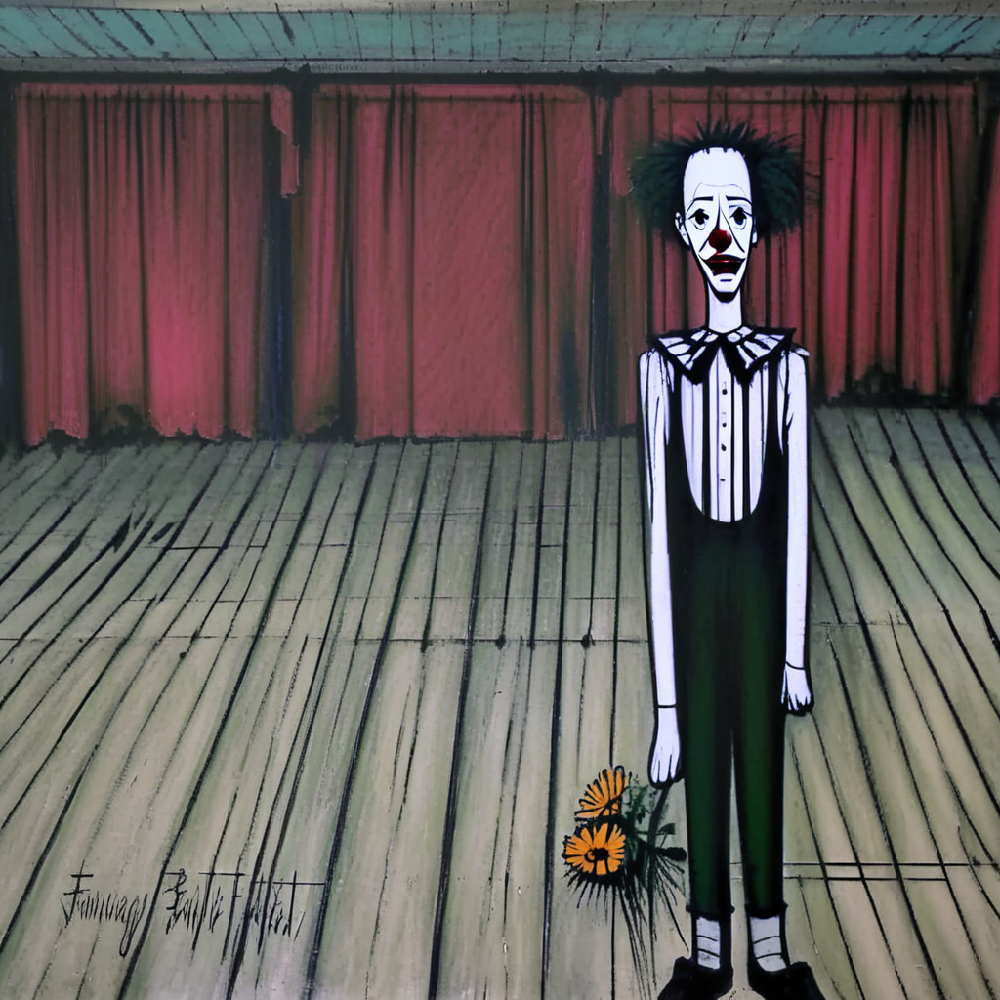

In [11]:
# Генерация изображения
prompt = "photo collage in BUFFET style, a weary clown standing on an abandoned circus stage, torn curtains, dust-covered floor, holding a broken flower. Rough, expressive lines."
image = pipe(prompt, num_inference_steps=50, guidance_scale=8.0).images[0]

# Результат
image


  0%|          | 0/50 [00:00<?, ?it/s]

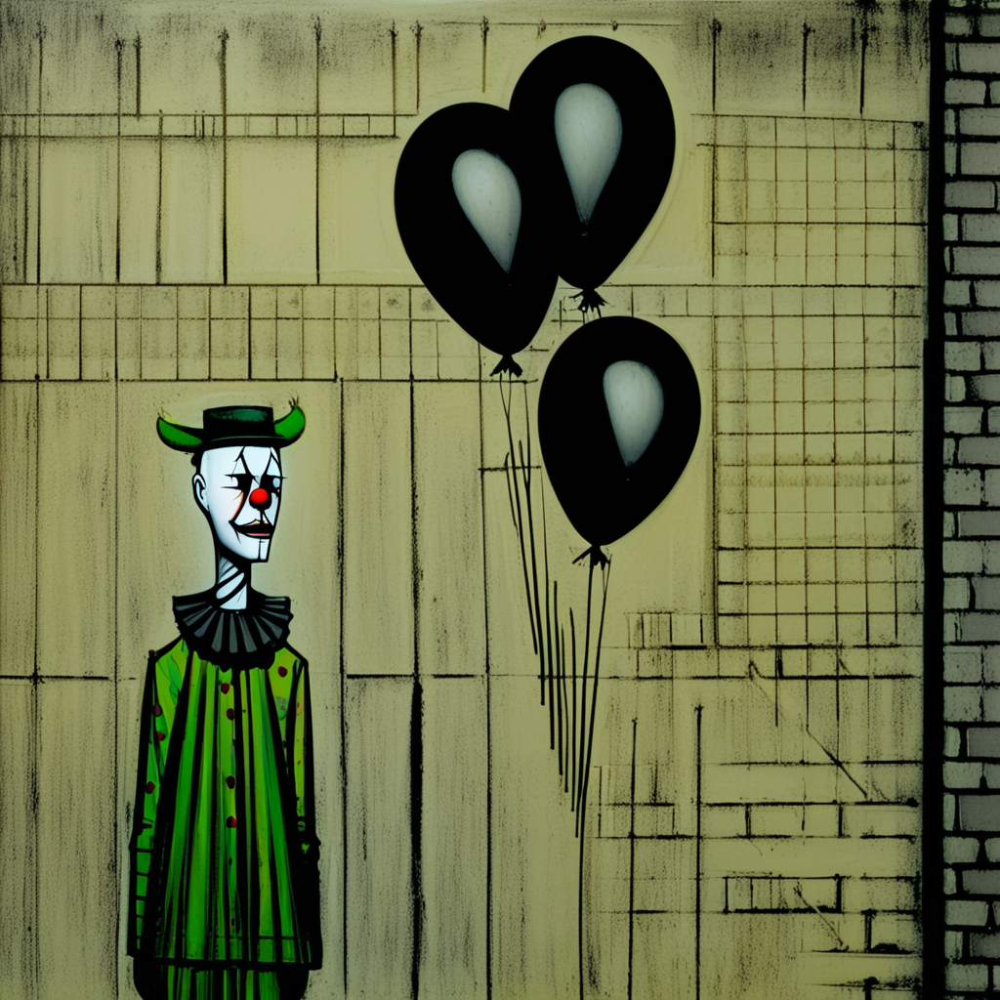

In [42]:
# Генерация изображения
prompt = "photo collage in BUFFET style, a lonely clown holding black balloons against a graffiti-covered brick wall, sad expression, cold urban atmosphere. Rough, expressive lines."
image = pipe(prompt, num_inference_steps=50, guidance_scale=8.0).images[0]

# Результат
image


  0%|          | 0/50 [00:00<?, ?it/s]

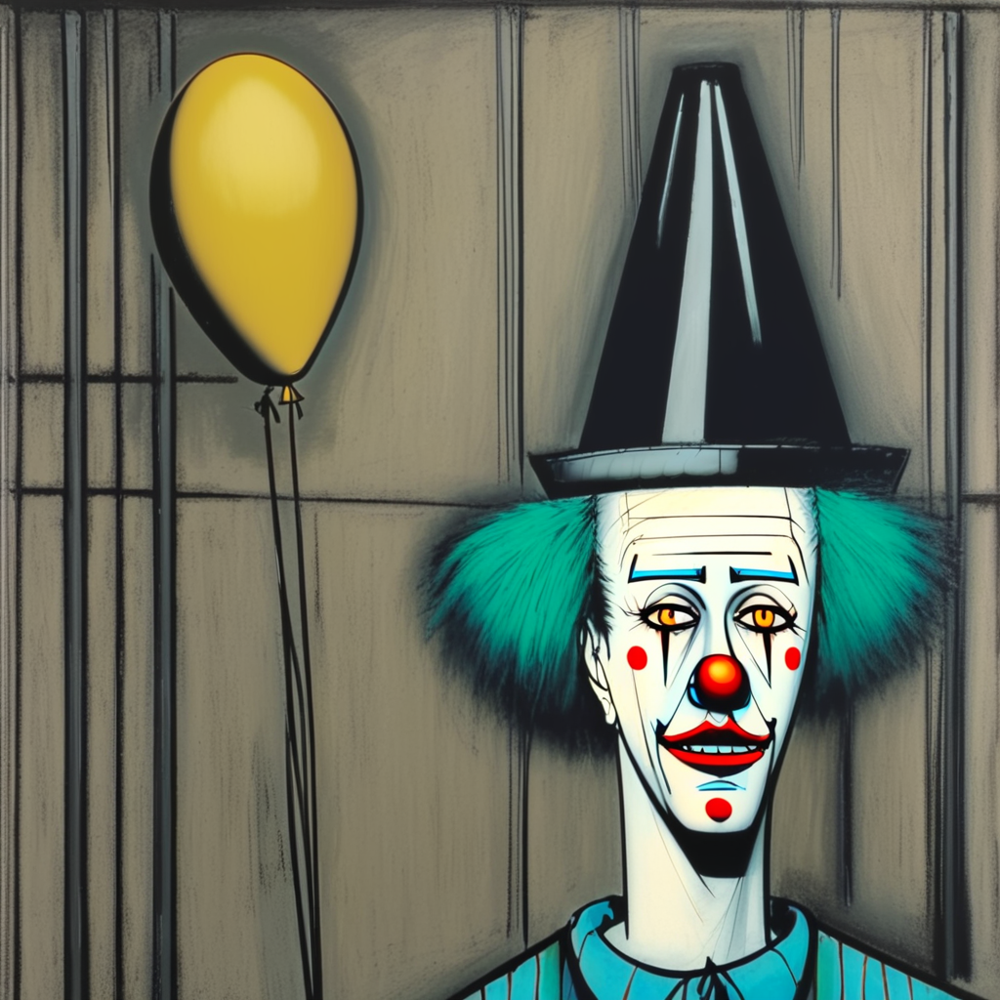

In [26]:
# Генерация изображения
prompt = "photo collage in BUFFET style, a lonely clown holding black balloons against a graffiti-covered brick wall, sad expression, cold urban atmosphere. Rough, expressive lines."
image = pipe(prompt, num_inference_steps=50, guidance_scale=8.0).images[0]

# Результат
image

  0%|          | 0/50 [00:00<?, ?it/s]

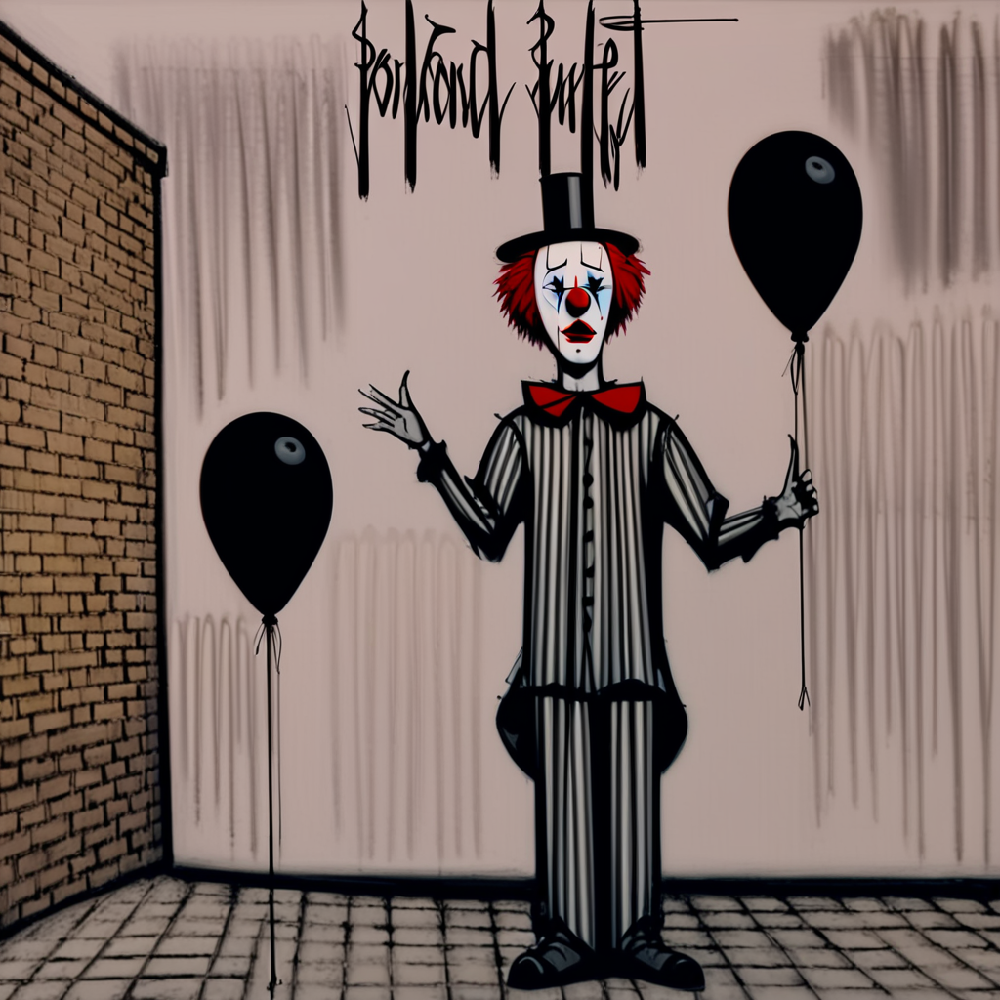

In [60]:
# Генерация изображения
prompt = "photo collage in BUFFET style, a lonely clown holding black balloons against a graffiti-covered brick wall, sad expression, cold urban atmosphere. Rough, expressive lines."
image = pipe(prompt, num_inference_steps=50, guidance_scale=8.0).images[0]

# Результат
image

  0%|          | 0/50 [00:00<?, ?it/s]

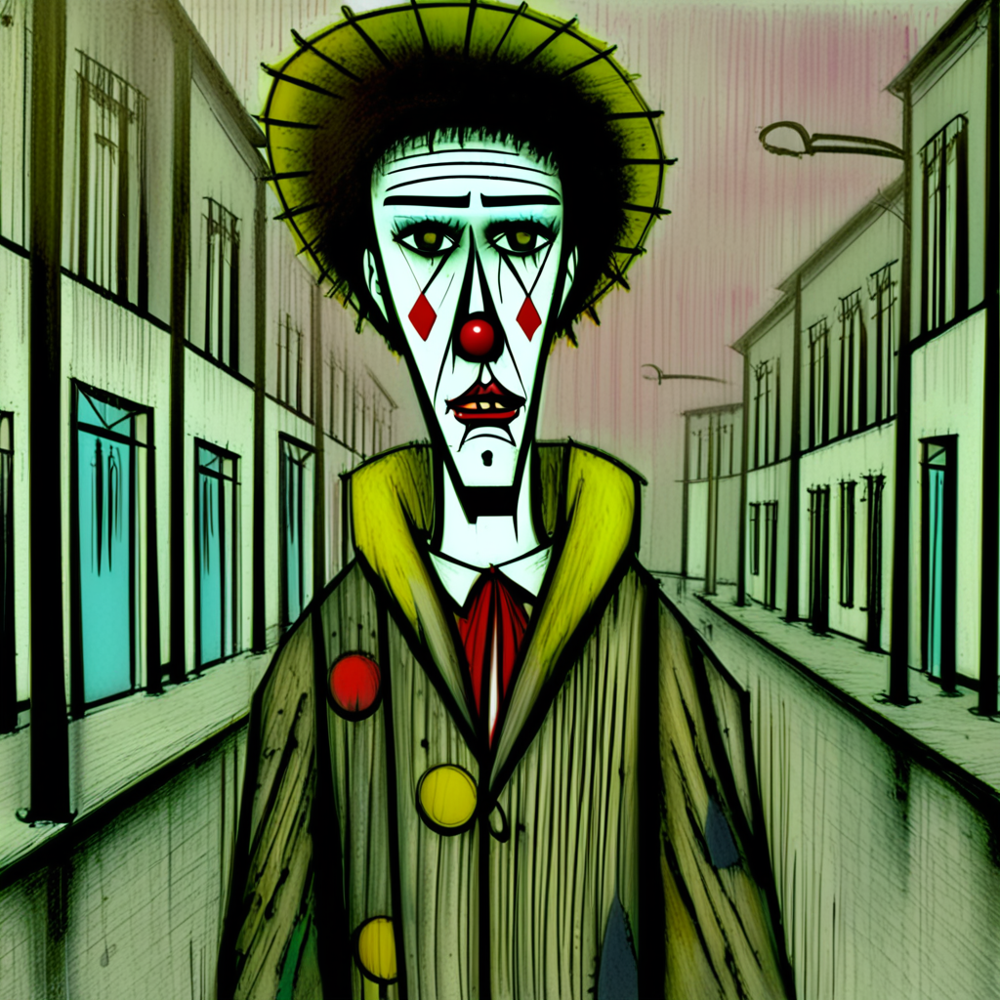

In [37]:
# Генерация изображения
prompt = "photo collage in BUFFET style, a sad drenched clown walking through an empty rainy street, makeup smudged, broken umbrella in hand. Rough, expressive lines."
image = pipe(prompt, num_inference_steps=50, guidance_scale=8.0).images[0]

# Результат
image


  0%|          | 0/50 [00:00<?, ?it/s]

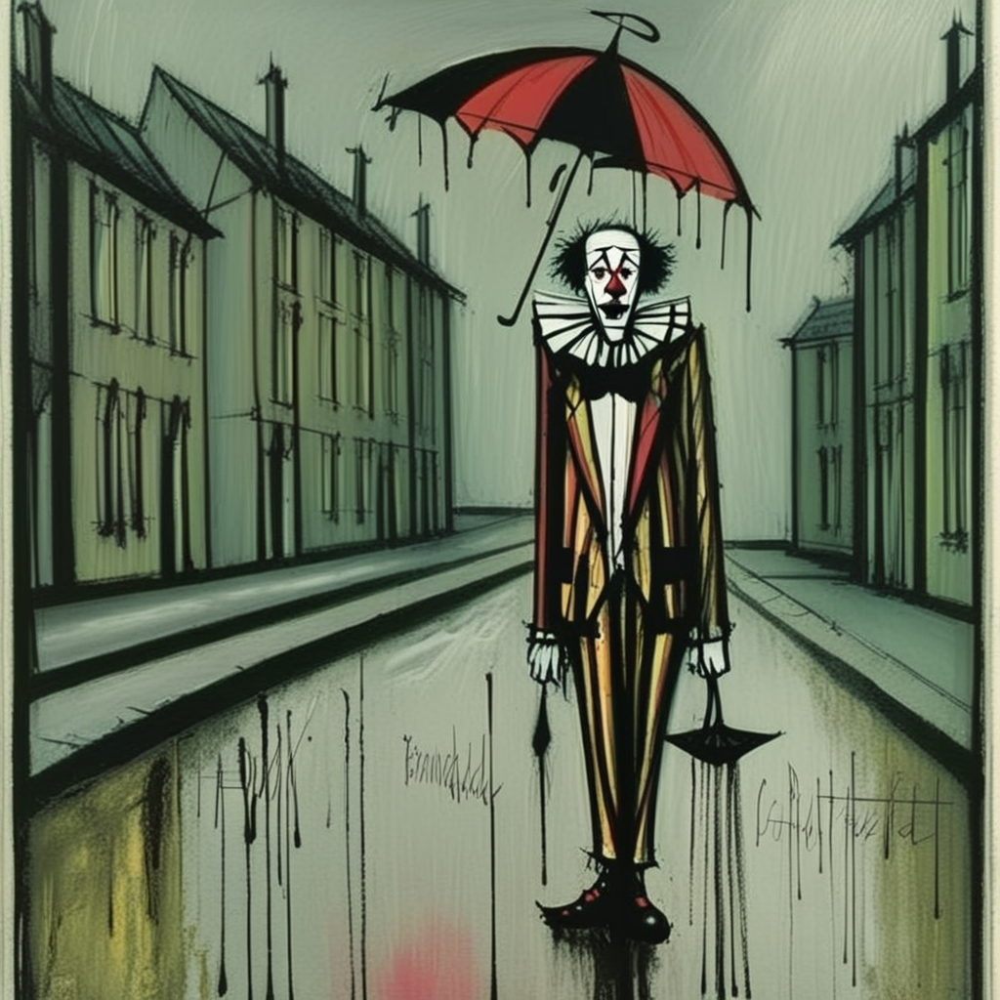

In [39]:
# Генерация изображения
prompt = "photo collage in BUFFET style, a drenched clown walking through an empty rainy street, makeup smudged, broken umbrella in hand. Rough, expressive lines."
image = pipe(prompt, num_inference_steps=50, guidance_scale=8.0).images[0]

# Результат
image

  0%|          | 0/50 [00:00<?, ?it/s]

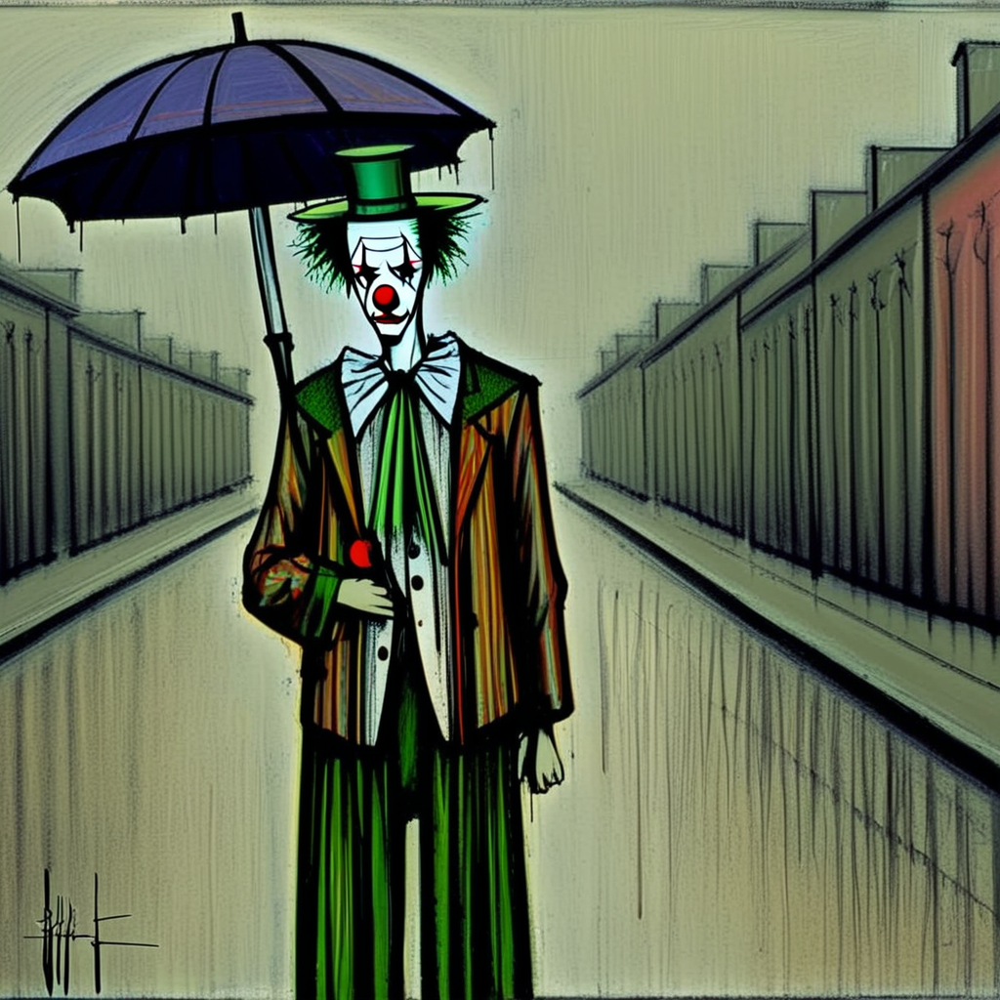

In [42]:
# Генерация изображения
prompt = "photo collage in BUFFET style, a drenched clown walking through an empty rainy street, makeup smudged, broken umbrella in hand. Rough, expressive lines."
image = pipe(prompt, num_inference_steps=50, guidance_scale=8.0).images[0]

# Результат
image

  0%|          | 0/50 [00:00<?, ?it/s]

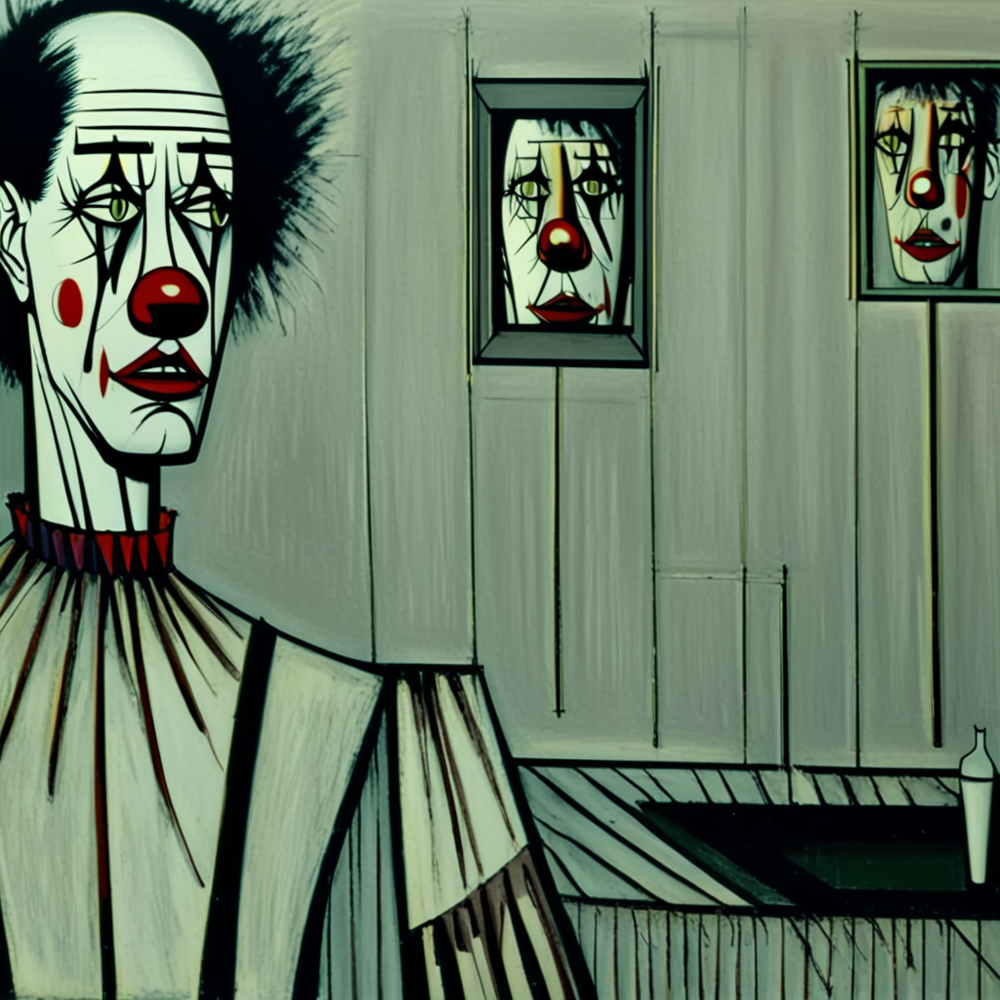

In [62]:
# Генерация изображения
prompt = "photo collage in BUFFET style, a clown staring at his fragmented reflection in a broken mirror, hand on his face, rough, expressive lines, cold gray tones."
image = pipe(prompt, num_inference_steps=50, guidance_scale=8.0).images[0]

# Результат
image